In [2]:
#utilities
import requests
import json
import time
import datetime
from dateutil.parser import parse
from dateutil import tz

#analysis
import pandas as pd
from pandas.io.json import json_normalize
import numpy as np
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()

#visualization
from matplotlib import pyplot as plt
import folium
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
import plotly.figure_factory as ff
import plotly.io as pio
pio.renderers.default = 'jupyterlab'

#html
from IPython.display import Javascript
from IPython.core.display import display, HTML

#DB connect
from pymongo import MongoClient

#text analysis
from PIL import Image
from wordcloud import WordCloud
import re
import string
import pythainlp
import warnings
warnings.filterwarnings("ignore")

In [3]:
covid_summary = requests.get('https://api.covid19api.com/summary')
summary = pd.DataFrame.from_dict(covid_summary.json()["Countries"])
date = covid_summary.json()['Date']

In [4]:
total = summary.sort_values(by='NewConfirmed', ascending=False)[['NewConfirmed', 'NewDeaths', 'NewRecovered']].sum()
total['Date'] = f'{parse(date):%d/%m/%Y %H:%M}'
total = pd.DataFrame(total).T
total

,NewConfirmed,NewDeaths,NewRecovered,Date
0,17793,828,2367,19/03/2020 10:27


In [5]:
temp = summary.sort_values(by='NewConfirmed', ascending=False)[['Country', 'NewConfirmed', 'NewDeaths', 'NewRecovered']]
temp = temp.reset_index(drop=True)
temp.style.background_gradient(cmap='PuRd')

,Country,NewConfirmed,NewDeaths,NewRecovered
0,Italy,4207,475,1084
1,Germany,3070,4,38
2,Spain,2162,90,53
3,France,1406,0,0
4,US,1362,10,-17
5,Iran,1192,147,0
6,United Kingdom,682,16,14
7,Netherlands,347,15,0
8,Switzerland,328,1,11
9,Austria,314,1,8


In [6]:
temp = summary.sort_values(by='TotalConfirmed', ascending=False)[['Country', 'TotalConfirmed', 'TotalDeaths', 'TotalRecovered']]
temp = temp.reset_index(drop=True)
temp.style.background_gradient(cmap='PuRd')

,Country,TotalConfirmed,TotalDeaths,TotalRecovered
0,China,81102,3241,69755
1,Italy,35713,2978,4025
2,Iran,17361,1135,5389
3,Spain,13910,623,1081
4,Germany,12327,28,105
5,France,9105,148,12
6,"Korea, South",8413,84,1540
7,US,7783,118,0
8,Switzerland,3028,28,15
9,United Kingdom,2642,72,67


In [7]:
full_latest = pd.read_csv('./data/covid_19_clean_complete.csv')

# cases 
cases = ['Confirmed', 'Deaths', 'Recovered', 'Active']

# Active Case = confirmed - deaths - recovered
full_latest['Active'] = full_latest['Confirmed'] - full_latest['Deaths'] - full_latest['Recovered']

# replacing Mainland china with just China
full_latest['Country/Region'] = full_latest['Country/Region'].replace('Mainland China', 'China')

# filling missing values 
full_latest[['Province/State']] = full_latest[['Province/State']].fillna('')
full_latest[cases] = full_latest[cases].fillna(0)

# format datetime
full_latest['Date'] = pd.to_datetime(full_latest['Date'])

In [8]:
m = folium.Map(location=[0, 0], tiles='cartodbpositron',
               min_zoom=2, max_zoom=4, zoom_start=2)

for i in range(0, len(full_latest)):
    folium.Circle(
        location=[full_latest.iloc[i]['Lat'], full_latest.iloc[i]['Long']],
        color='crimson', 
        tooltip =   '<li><bold>Country : '+str(full_latest.iloc[i]['Country/Region'])+
                    '<li><bold>Province : '+str(full_latest.iloc[i]['Province/State'])+
                    '<li><bold>Confirmed : '+str(full_latest.iloc[i]['Confirmed'])+
                    '<li><bold>Deaths : '+str(full_latest.iloc[i]['Deaths'])+
                    '<li><bold>Recovered : '+str(full_latest.iloc[i]['Recovered']),
        radius=int(full_latest.iloc[i]['Confirmed'])**1.1,
        fill_color='crimson').add_to(m)
m

In [9]:
formated_gdf = full_latest.groupby(['Date', 'Country/Region'])['Confirmed', 'Deaths', 'Recovered'].max()
formated_gdf = formated_gdf.reset_index()
formated_gdf['Date'] = pd.to_datetime(formated_gdf['Date'])
formated_gdf['Date'] = formated_gdf['Date'].dt.strftime('%d-%m-%Y')
formated_gdf['size'] = formated_gdf['Confirmed'].pow(0.3)

In [12]:
fig = px.scatter_geo(formated_gdf, locations="Country/Region", locationmode='country names', 
                     color="Confirmed", size='size', hover_name="Country/Region", 
                     range_color= [0, max(formated_gdf['Confirmed'])+2], 
                     projection="natural earth", animation_frame="Date", 
                     title='Spread over time')
fig.update(layout_coloraxis_showscale=True)
HTML(fig.to_html())

AttributeError: module 'plotly' has no attribute 'validators'

In [13]:
with open('./outputs/spreading_over_time.html', 'w') as file:
    file.write(fig.to_html())

NameError: name 'fig' is not defined

In [14]:
# color pallette
cnf = '#393e46' # confirmed - grey
dth = '#ff2e63' # death - red
rec = '#21bf73' # recovered - cyan
act = '#fe9801' # active case - yellow

In [15]:
temp = full_latest.sort_values(by='Date').groupby('Date')['Recovered', 'Deaths', 'Active'].sum().reset_index()
temp = temp.melt(id_vars="Date", value_vars=['Recovered', 'Deaths', 'Active'],
                 var_name='Case', value_name='Count')
temp.head()

fig = px.area(temp, x="Date", y="Count", color='Case',
             title='Global: Cases over time', color_discrete_sequence = [rec, dth, act])
HTML(fig.to_html())

In [16]:
with open('./outputs/global_cases.html', 'w') as file:
    file.write(fig.to_html())

In [17]:
HTML('''<div class="flourish-embed flourish-bar-chart-race" data-src="visualisation/1571387"><script src="https://public.flourish.studio/resources/embed.js"></script></div>''')

In [18]:
temp = full_latest[full_latest['Country/Region'] == 'Thailand'].sort_values(by='Date').groupby('Date')['Recovered', 'Deaths', 'Active'].sum().reset_index()
temp = temp.melt(id_vars="Date", value_vars=['Recovered', 'Deaths', 'Active'],
                 var_name='Case', value_name='Count')
temp.head()

fig = px.area(temp, x="Date", y="Count", color='Case',
             title='Thailand: Cases over time', color_discrete_sequence = [rec, dth, act])
HTML(fig.to_html())

In [19]:
conn = MongoClient()

In [20]:
tweets = conn['data_engineer']['tweets']

In [21]:
all_tweet_text = pd.DataFrame(list(tweets.find({}, {"_id":0, "created_at": 1, "text":1, "extended_tweet.full_text": 1})))
all_tweet_w_location = pd.DataFrame(list(tweets.find({"geo": {"$ne": "null"}}, {"_id":0, "created_at": 1, "text":1, "coordinates.coordinates": 1, "place.name": 1})))

In [22]:
all_tweet_w_location.dropna(inplace=True)

In [23]:
long = []
lat = []
for key, value in all_tweet_w_location.coordinates.items():
    for k, v in value.items():
        long.append(v[0])
        lat.append(v[1])

In [24]:
place = []
for key, value in all_tweet_w_location.place.items():
    for k, v in value.items():
        place.append(v)

In [25]:
all_tweet_w_location['long'] = long
all_tweet_w_location['lat'] = lat
all_tweet_w_location['place'] = place

In [26]:
fig = go.Figure(data=go.Scattergeo(
        lon = all_tweet_w_location['long'],
        lat = all_tweet_w_location['lat'],
        text = all_tweet_w_location['text'],
        mode = 'markers',
        hovertemplate='text: %{text}',
        ))

fig.update_layout(
        title = 'Tweets with location on',
        geo=dict(scope='asia', projection_type='natural earth', showland=True, showrivers=True, center={'lat': 13, 'lon': 100})
    )
HTML(fig.to_html())

In [27]:
all_tweet_text['created_at'] = pd.to_datetime(all_tweet_text['created_at'])
all_tweet_text['hour'] = pd.DatetimeIndex(all_tweet_text['created_at']).hour + 7 #Convert UTC time -> GMT+7

In [28]:
temp = all_tweet_text.groupby('hour').agg('count').reset_index()
fig = go.Scatter(
    x=temp.hour,
    y=temp.text,
    mode='markers+lines',
    line=dict(
        color="Orange"),
    marker=dict(
        color="Orange"))

layout = go.Layout(
    title='Number of tweet count hourly',
    xaxis=dict(
        title='Hour',
        showgrid=False
    ),
    yaxis=dict(
        title='Tweet count'
    ))

fig = go.Figure(data=fig, layout=layout)

HTML(fig.to_html())

In [29]:
latest_tweets = list(all_tweet_text['text'])

In [30]:
def clean_msg(msg):
    msg = re.sub(r'#','',msg)
    msg = re.sub(r'http\S+', '', msg)
    msg = re.sub(r'[^ก-๙a-zA-Z0-9\']+', '', msg)
    for c in string.punctuation:
        msg = re.sub(r'\{}'.format(c),'',msg)
    msg = ' '.join(msg.split())
    return msg

In [31]:
clean_tweets = [clean_msg(tweet) for tweet in latest_tweets]

In [32]:
bagging = ' '.join(map(str, clean_tweets))
bagging = pythainlp.word_tokenize(bagging, engine='deepcut')
bagging = ' '.join(map(str, bagging))

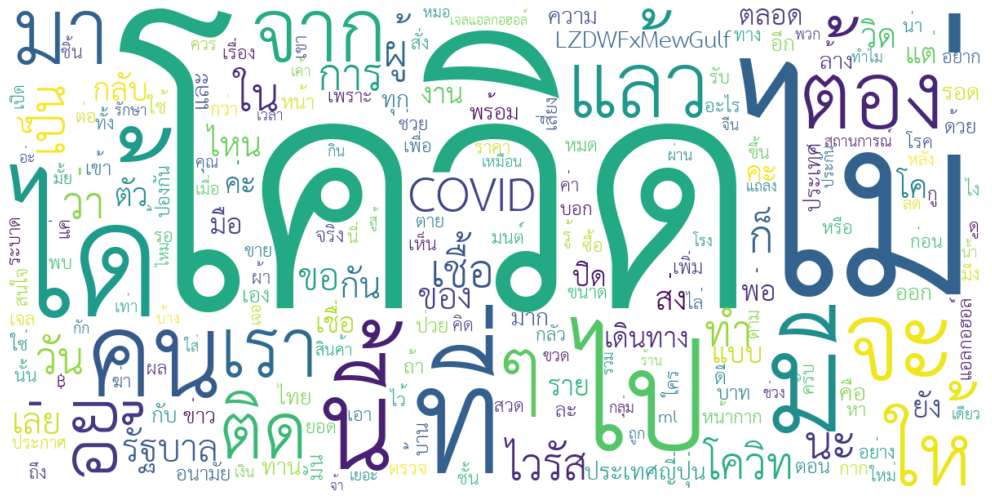

In [33]:
plt.figure(figsize=(20,9))
wordcloud = WordCloud(font_path='./data/THSarabunNew.ttf',
                      relative_scaling = 0.8,
                      min_font_size=1,
                      background_color="white",
                      scale=3,
                      font_step=1,
                      collocations=False,
                      regexp=r"[\u0E00-\u0E7Fa-zA-Z']+",
                      margin=2
                      ).generate(bagging)
plt.imshow(wordcloud, cmap=plt.cm.gray, interpolation='bilinear')
plt.axis("off")
plt.savefig('./outputs/wordcloud.png')
plt.show()